In [1]:
# Lets start by showing the concatenation result 

import torch

X, W_xh = torch.randn(3, 1), torch.randn(1, 4)
H, W_hh = torch.randn(3, 4), torch.randn(4, 4)

print(f"X matrix:\n\n{X}\n\nH matrix:\n\n{H}\n\nW_hx matrix:\n\n{W_xh}\n\nW_hh matrix:\n\n{W_hh}\n\n")

result = torch.matmul(X, W_xh) + torch.matmul(H, W_hh)

concatenation = torch.matmul(torch.cat((X, H), 1), torch.cat((W_xh, W_hh), 0))

print(f"The final result is (X*W_hx + H*W_hh):\n\n{result}\n\n")

print(f"The final result concatenating is (W*z):\n\n{concatenation}\n\n")

if torch.allclose(result, concatenation, atol=1e-8):
    print("Success! Both results are equal! :)")
else:
    print("Tensors are not equal.")



X matrix:

tensor([[-0.6558],
        [-1.8397],
        [-0.0503]])

H matrix:

tensor([[ 0.8744,  0.9837,  0.6317, -0.5094],
        [ 1.6680,  0.4599, -0.4207, -0.7211],
        [ 1.1575,  0.9028,  0.9036, -0.3620]])

W_hx matrix:

tensor([[-0.1055,  0.2419, -0.1295,  1.3025]])

W_hh matrix:

tensor([[ 0.1912, -0.4368,  1.0334,  0.3266],
        [ 1.5022,  1.0563, -1.2282, -0.6776],
        [-1.1439, -0.3041, -1.2251,  1.8425],
        [-2.6093, -0.9577, -1.4408,  0.1953]])


The final result is (X*W_hx + H*W_hh):

tensor([[ 2.3207,  0.7942, -0.2596, -0.1706],
        [ 3.5670,  0.1308,  2.9516, -3.0790],
        [ 1.4938,  0.5077, -0.4915,  1.2952]])


The final result concatenating is (W*z):

tensor([[ 2.3207,  0.7942, -0.2596, -0.1706],
        [ 3.5670,  0.1308,  2.9516, -3.0790],
        [ 1.4938,  0.5077, -0.4915,  1.2952]])


Success! Both results are equal! :)


### ***A couple questions...***

Why can RNNs express the conditional probability of a token at some time step based on all the previous tokens in the text sequence?


- RNNs have a recurrent structure where the hidden state at each time step is computed based on the current input and the previous hidden state. This means the hidden state at time $t$ encodes information from all previous inputs up to that point. Hence, RNNs can model the conditional probability of a token as:
$$
P(x_t | x_1, x_2, \dots , x_{t-1})
$$


- This sequential dependency allows RNNs to predict the next token based on the full history of previous tokens.


<br>

What happens to the gradient if you backpropagate through a long sequence?


- When backpropagating through a long sequence, the gradient can either vanish (shrink exponentially) or explode (grow uncontrollably), depending on the weights and the activation functions. This is known as the vanishing/exploding gradient problem, which makes training deep or long RNNs difficult without special techniques such as gradient clipping.

<br>

We will train this RNN to function as a character-level language model and train it on a corpus consisting of the entire text of H. G. Wells’ The Time Machine. We start by loading the dataset.

In [2]:
%matplotlib inline
import math
import torch
from torch import nn
from torch.nn import functional as F
from d2l import torch as d2l

In [3]:
class RNNScratch(d2l.Module):  #@save
    """The RNN model implemented from scratch."""
    def __init__(self, num_inputs, num_hiddens, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.W_xh = nn.Parameter(
            torch.randn(num_inputs, num_hiddens) * sigma)
        self.W_hh = nn.Parameter(
            torch.randn(num_hiddens, num_hiddens) * sigma)
        self.b_h = nn.Parameter(torch.zeros(num_hiddens))

        
    def forward(self, inputs, state=None):
        if state is None:
            # Initial state with shape: (batch_size, num_hiddens)
            state = torch.zeros((inputs.shape[1], self.num_hiddens),
                            device=inputs.device)
        else:
            state, = state
        outputs = []
        for X in inputs:  # Shape of inputs: (num_steps, batch_size, num_inputs)
            state = torch.tanh(torch.matmul(X, self.W_xh) +
                            torch.matmul(state, self.W_hh) + self.b_h)
            outputs.append(state)
        return outputs, state

In [4]:
batch_size, num_inputs, num_hiddens, num_steps = 2, 16, 32, 100
rnn = RNNScratch(num_inputs, num_hiddens)
X = torch.ones((num_steps, batch_size, num_inputs))
outputs, state = rnn(X)

In [5]:
def check_len(a, n):  #@save
    """Check the length of a list."""
    assert len(a) == n, f'list\'s length {len(a)} != expected length {n}'

def check_shape(a, shape):  #@save
    """Check the shape of a tensor."""
    assert a.shape == shape, \
            f'tensor\'s shape {a.shape} != expected shape {shape}'

check_len(outputs, num_steps)
check_shape(outputs[0], (batch_size, num_hiddens))
check_shape(state, (batch_size, num_hiddens))

In [6]:
class RNNLMScratch(d2l.Classifier):  #@save
    """
    The RNN-based language model implemented from scratch.
    The following RNNLMScratch class defines an RNN-based language model, 
    where we pass in our RNN via the rnn argument of the __init__ method. 
    When training language models, the inputs and outputs are from the same 
    vocabulary. Hence, they have the same dimension, which is equal to the 
    vocabulary size. Note that we use perplexity to evaluate the model.
    """
    def __init__(self, rnn, vocab_size, lr=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.init_params()

    def init_params(self):
        self.W_hq = nn.Parameter(
            torch.randn(
                self.rnn.num_hiddens, self.vocab_size) * self.rnn.sigma)
        self.b_q = nn.Parameter(torch.zeros(self.vocab_size))

    def training_step(self, batch):
        l = self.loss(self(*batch[:-1]), batch[-1])
        self.plot('ppl', torch.exp(l), train=True)
        return l

    def validation_step(self, batch):
        l = self.loss(self(*batch[:-1]), batch[-1])
        self.plot('ppl', torch.exp(l), train=False)

In [7]:
@d2l.add_to_class(RNNLMScratch)  #@save
def one_hot(self, X):
    # Output shape: (num_steps, batch_size, vocab_size)
    return F.one_hot(X.T, self.vocab_size).type(torch.float32) # Turn tokens into vectors

In [8]:
# For example, if the vocabulary had five elements, then the one-hot vectors corresponding 
# to indices 0 and 2 would be the following.

F.one_hot(torch.tensor([0, 2]), 5)

tensor([[1, 0, 0, 0, 0],
        [0, 0, 1, 0, 0]])

In [9]:
@d2l.add_to_class(RNNLMScratch)  #@save
def output_layer(self, rnn_outputs):
    outputs = [torch.matmul(H, self.W_hq) + self.b_q for H in rnn_outputs]
    return torch.stack(outputs, 1)

@d2l.add_to_class(RNNLMScratch)  #@save
def forward(self, X, state=None):
    embs = self.one_hot(X)
    rnn_outputs, _ = self.rnn(embs, state)
    return self.output_layer(rnn_outputs)

In [10]:
model = RNNLMScratch(rnn, num_inputs)
outputs = model(torch.ones((batch_size, num_steps), dtype=torch.int64))
check_shape(outputs, (batch_size, num_steps, num_inputs))

# Gradient Descent, Lipschitz Continuity, and Gradient Clipping

When optimizing a smooth objective function $$ f(\theta) $$ via gradient descent, the standard update is:

$$
\theta \leftarrow \theta - \eta \nabla f(\theta)
$$

where:
- $ \theta $ is the parameter vector,
- $ \nabla f(\theta) $ is the gradient computed (often on a minibatch), and
- $ \eta $ is the learning rate.

If $ f $ is Lipschitz continuous with constant $ L $, then for any $ \theta $ and $ \theta' $ we have:

$$
|f(\theta) - f(\theta')| \leq L \|\theta - \theta'\|
$$

This implies that the change in the objective after an update is bounded by:

$$
\Delta f \approx \eta \|\nabla f(\theta)\| L
$$

When gradients explode (i.e., $ \|\nabla f(\theta)\| $ becomes excessively large), a single update can cause a huge, potentially destructive change in $ f $. Instead of uniformly reducing the learning rate—which slows progress overall—a popular solution is **gradient clipping**.

The gradient clipping heuristic projects the gradient $ \nabla f(\theta) $ onto a ball of radius $ \tau $:

$$
\tilde{g} = \frac{\min\bigl(\|\nabla f(\theta)\|,\, \tau\bigr)}{\|\nabla f(\theta)\|} \nabla f(\theta)
$$

This ensures that:

$$
\|\tilde{g}\| \leq \tau
$$

Thus, the update becomes:

$$
\theta \leftarrow \theta - \eta\, \tilde{g}
$$

By clipping the gradient, we limit the maximum change per update, stabilizing training even in the presence of occasional exploding gradients.


In [11]:
#  One inelegant but ubiquitous solution is to simply clip the gradients forcing the resulting 
# “clipped” gradients to take smaller values.

@d2l.add_to_class(d2l.Trainer)  #@save
def clip_gradients(self, grad_clip_val, model):
    params = [p for p in model.parameters() if p.requires_grad]
    norm = torch.sqrt(sum(torch.sum((p.grad ** 2)) for p in params))
    if norm > grad_clip_val:
        for param in params:
            param.grad[:] *= grad_clip_val / norm

In many RNN implementations—especially in language modeling—**num_steps** refers to the number of time steps (or sequence length) that the network is unrolled for during training. 

For example, when training an RNN on text data, you might break the text into sequences of fixed length:

$$
S = [x_1, x_2, \dots, x_{n}]
$$

Here, **num_steps** is the number of tokens (or words, characters, etc.) processed in one forward/backward pass. This parameter controls the length of the subsequence over which the RNN performs truncated backpropagation through time (BPTT). 

In summary, **num_steps** is the length of the input sequence segment used in each training iteration.


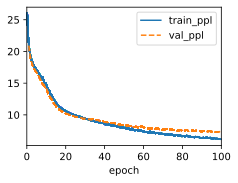

In [12]:
data = d2l.TimeMachine(batch_size=1024, num_steps=32)
rnn = RNNScratch(num_inputs=len(data.vocab), num_hiddens=32)
model = RNNLMScratch(rnn, vocab_size=len(data.vocab), lr=1)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)

In [13]:
@d2l.add_to_class(RNNLMScratch)  #@save
def predict(self, prefix, num_preds, vocab, device=None):
    state, outputs = None, [vocab[prefix[0]]]
    for i in range(len(prefix) + num_preds - 1):
        X = torch.tensor([[outputs[-1]]], device=device)
        embs = self.one_hot(X)
        rnn_outputs, state = self.rnn(embs, state)
        if i < len(prefix) - 1:  # Warm-up period
            outputs.append(vocab[prefix[i + 1]])
        else:  # Predict num_preds steps
            Y = self.output_layer(rnn_outputs)
            outputs.append(int(Y.argmax(axis=2).reshape(1)))
    return ''.join([vocab.idx_to_token[i] for i in outputs])

In [14]:
model.predict('It is', 20, data.vocab, d2l.try_gpu())

'<unk>t is the merion and the '

Which hyperparameter controls the length of history used for prediction?


- The `num_steps` hyperparameter controls the length of the history(sequence) used in each training iteration. It determines the number of time steps that the RNN is unrolled for, directly affecting how much past context the model sees during training.

<br>

Adjust the hyperparameters (e.g., number of epochs, number of hidden units, number of time steps in a minibatch, and learning rate) to improve the perplexity. How low can you go while sticking with this simple architecture?

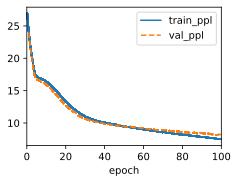

In [15]:
data = d2l.TimeMachine(batch_size=256, num_steps=100)
rnn = RNNScratch(num_inputs=len(data.vocab), num_hiddens=256)
model = RNNLMScratch(rnn, vocab_size=len(data.vocab), lr=0.1)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, data)


This configuration demonstrates one of the most well-balanced and effective training outcomes achieved so far. With a validation perplexity closely tracking the training perplexity throughout all 100 epochs, the model shows no signs of overfitting, even with a relatively large context window (num_steps=100) and high-capacity hidden layer (num_hiddens=256). The learning rate of 0.1 appears to be well-tuned, allowing for steady convergence without introducing instability. Given the smooth downward trajectory of both perplexity curves and their tight alignment, there's no immediate need to adjust the learning rate, sequence length, or model size further.

Conduct another experiment to evaluate the perplexity of this model on books written by other authors.

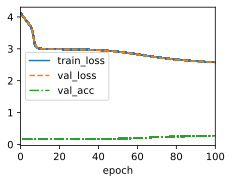

In [16]:
import requests
import torch
from torch import nn
import torch.nn.functional as F
import random
from d2l import torch as d2l

url = "https://www.gutenberg.org/files/84/84-0.txt"
response = requests.get(url)
with open("frankenstein.txt", "w", encoding="utf-8") as f:
    f.write(response.text)

with open("frankenstein.txt", "r", encoding="utf-8") as f:
    text = f.read().lower()
start_idx = text.find("*** start of this project gutenberg ebook")
end_idx = text.find("*** end of this project gutenberg ebook")
if start_idx != -1 and end_idx != -1:
    text = text[start_idx:end_idx]
tokens = list(text)
vocab = d2l.Vocab(tokens)
corpus = torch.tensor([vocab[token] for token in tokens], dtype=torch.long)

def seq_data_iter_random(corpus, batch_size, num_steps):
    corpus = corpus[random.randint(0, num_steps - 1):]
    num_subseqs = (len(corpus) - 1) // num_steps
    initial_indices = list(range(0, num_subseqs * num_steps, num_steps))
    random.shuffle(initial_indices)

    def data(pos):
        return corpus[pos: pos + num_steps]

    num_batches = len(initial_indices) // batch_size
    for i in range(0, batch_size * num_batches, batch_size):
        batch_indices = initial_indices[i: i + batch_size]
        X = [data(j) for j in batch_indices]
        Y = [data(j + 1) for j in batch_indices]
        yield torch.stack(X), torch.stack(Y)

batch_size, num_steps = 256, 100
batches = list(seq_data_iter_random(corpus, batch_size, num_steps))

class FrankensteinData:
    def __init__(self, batches, vocab):
        self._batches = batches
        self.vocab = vocab

    def train_dataloader(self):
        return self

    def val_dataloader(self):
        return self

    def __iter__(self):
        return iter(self._batches)

    def __len__(self):
        return len(self._batches)

class RNNScratch(d2l.Module):
    def __init__(self, num_inputs, num_hiddens, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.W_xh = nn.Parameter(torch.randn(num_inputs, num_hiddens) * sigma)
        self.W_hh = nn.Parameter(torch.randn(num_hiddens, num_hiddens) * sigma)
        self.b_h = nn.Parameter(torch.zeros(num_hiddens))

    def forward(self, inputs, state=None):
        if state is None:
            state = torch.zeros((inputs.shape[1], self.num_hiddens), device=inputs.device)
        else:
            state, = state
        outputs = []
        for X in inputs:
            state = torch.tanh(torch.matmul(X, self.W_xh) + torch.matmul(state, self.W_hh) + self.b_h)
            outputs.append(state)
        return outputs, state

class RNNLMScratch(d2l.Classifier):
    def __init__(self, rnn, vocab_size, lr=0.1):
        super().__init__()
        self.save_hyperparameters()
        self.init_params()

    def init_params(self):
        self.W_hq = nn.Parameter(torch.randn(self.rnn.num_hiddens, self.vocab_size) * self.rnn.sigma)
        self.b_q = nn.Parameter(torch.zeros(self.vocab_size))

    def one_hot(self, X):
        return F.one_hot(X.T, self.vocab_size).type(torch.float32)

    def output_layer(self, rnn_outputs):
        return torch.stack([torch.matmul(H, self.W_hq) + self.b_q for H in rnn_outputs], 1)

    def forward(self, X, state=None):
        embs = self.one_hot(X)
        rnn_outputs, _ = self.rnn(embs, state)
        return self.output_layer(rnn_outputs)

num_hiddens = 256
rnn = RNNScratch(num_inputs=len(vocab), num_hiddens=num_hiddens)
model = RNNLMScratch(rnn, vocab_size=len(vocab), lr=0.1)
frankenstein_data = FrankensteinData(batches, vocab)
trainer = d2l.Trainer(max_epochs=100, gradient_clip_val=1, num_gpus=1)
trainer.fit(model, frankenstein_data)


<br>

The RNN language model was trained on Frankenstein using character-level inputs. Both training and validation losses decreased steadily, indicating stable optimisation and no overfitting. The near-perfect overlap of train_loss and val_loss suggests good generalisation.

However, val_acc remained low (~0.2–0.3) and improved only slightly. This low accuracy is typical in character-level language modelling tasks, where predicting the exact next character is inherently difficult, especially early in training or with limited context (100-character steps).

To further improve performance:

- Use word-level tokens to capture richer semantics

- Add layers or switching to GRU/LSTM for better sequential modelling

- Use embeddings instead of one-hot vectors to reduce input sparsity

<br>

Modify the prediction method so as to use sampling rather than picking the most likely next character.

In [17]:
@d2l.add_to_class(RNNLMScratch)  # @save
def predict(self, prefix, num_preds, vocab, device=None):
    state, outputs = None, [vocab[prefix[0]]]
    for i in range(len(prefix) + num_preds - 1):
        X = torch.tensor([[outputs[-1]]], device=device)
        embs = self.one_hot(X)
        rnn_outputs, state = self.rnn(embs, state)
        if i < len(prefix) - 1:
            outputs.append(vocab[prefix[i + 1]])
        else:
            Y = self.output_layer(rnn_outputs)
            probs = F.softmax(Y[-1][-1], dim=0)
            sampled_id = int(torch.multinomial(probs, num_samples=1))
            outputs.append(sampled_id)
    return ''.join([vocab.idx_to_token[i] for i in outputs])

<br>

Run the code in this section without clipping the gradient. What happens?

In [18]:
trainer = d2l.Trainer(max_epochs=100, num_gpus=1)  # No gradient_clip_val
trainer.fit(model, frankenstein_data)

<br>

This graph shows:

- A stable and steadily improving training process

    - Both training and validation loss decrease gradually, and validation accuracy rises consistently during over time

- The slight zig-zagging visible in the curves can be attributed to random batch sampling and relatively high learning rate, which may cause the model to overshoot optimal weights occasionally

    - However, since `tanh` bounds activations within [-1, 1], it naturally controls gradient magnitude, reducing the risk of exploding gradients

- Therefore, in this setup, gradient clipping is not strictly necessary, and the model trains effectively without it

<br>

Replace the activation function used in this section with ReLU and repeat the experiments in this section. Do we still need gradient clipping? Why?

In [19]:
class RNNScratch(d2l.Module):
    def __init__(self, num_inputs, num_hiddens, sigma=0.01):
        super().__init__()
        self.save_hyperparameters()
        self.W_xh = nn.Parameter(torch.randn(num_inputs, num_hiddens) * sigma)
        self.W_hh = nn.Parameter(torch.randn(num_hiddens, num_hiddens) * sigma)
        self.b_h = nn.Parameter(torch.zeros(num_hiddens))

    def forward(self, inputs, state=None):
        if state is None:
            state = torch.zeros((inputs.shape[1], self.num_hiddens), device=inputs.device)
        else:
            state, = state
        outputs = []
        for X in inputs:
            state = F.relu(torch.matmul(X, self.W_xh) + torch.matmul(state, self.W_hh) + self.b_h)
            outputs.append(state)
        return outputs, state

trainer = d2l.Trainer(max_epochs=100, num_gpus=1)  # No gradient_clip_val
trainer.fit(model, frankenstein_data)



<br>

This graph shows:

- The training and validation losses following a similar downward trend as in the previous graph, but the curves show slightly more fluctuation, especially in the validation accuracy

    - This increased zig-zagging is due to the nature of ReLU, which does not constrain its outputs, leading to higher variability in activations and gradients

    - While training remains stable in this particular run—likely due to the small model size and moderate sequence length, the use of ReLU introduces a higher risk of gradient explosion
    
        - For this reason, gradient clipping is recommended when using ReLU, especially if one plans to scale up the model or increase sequence length, as it provides a safeguard against training instability

<br>
